In [27]:
import numpy as np 
import matplotlib
import random
import pandas as pd
import csv
import matplotlib.pyplot as plt
import seaborn as sbn
import datetime
from datetime import datetime
from datetime import date
import sklearn
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import normalize
from sklearn.model_selection  import train_test_split
from sklearn.base import BaseEstimator
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.linear_model import SGDClassifier
from time import strptime
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve
from sklearn.metrics import classification_report
from sklearn.compose import ColumnTransformer
from matplotlib.widgets import Slider

import warnings
warnings.filterwarnings("ignore")

matplotlib.use("Agg")
import sklearn.tree, sklearn.preprocessing, sklearn.pipeline, sklearn.impute, sklearn.compose

import ipympl 
%matplotlib widget

In [28]:
file_name_train = "train.csv"
file_name_test = "test.csv"
df_train = pd.read_csv(file_name_train, sep=',')  #Removing the semi colons in the csv and creating a data frame
df_test = pd.read_csv(file_name_test, sep=',')
display(df_train)  #This is the raw data, unclean, unsectioned 

print(df_train.shape)

,id,valid_time,latitude,longitude,tp,u10,v10,sp,u100,v100,tcc,ptype,t2m
0,1,2018-01-01 00:00:00,59.0,-8.00,3.814697e-06,1.405868,-1.367767,98134.810,1.516388,-1.468002,0.968842,1.0,279.75903
1,2,2018-01-01 00:00:00,59.0,-7.75,1.668930e-05,2.151962,-1.555267,98086.810,2.239044,-1.634994,0.978790,1.0,279.61255
2,3,2018-01-01 00:00:00,59.0,-7.50,1.811981e-05,2.691025,-1.585541,98078.810,2.783966,-1.686752,0.975586,1.0,279.71997
3,4,2018-01-01 00:00:00,59.0,-7.25,1.907349e-05,2.850204,-1.714447,98076.810,2.971466,-1.854721,0.978790,1.0,279.78247
4,5,2018-01-01 00:00:00,59.0,-7.00,1.525879e-05,3.299423,-1.867767,98084.810,3.455841,-2.001205,0.968842,1.0,279.86646
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13288915,13288916,2018-12-31 23:00:00,50.0,1.00,1.239777e-05,2.973770,-0.559326,102930.375,4.842743,-1.398544,0.967163,1.0,282.03857
13288916,13288917,2018-12-31 23:00:00,50.0,1.25,1.621246e-05,2.772598,-0.156982,102743.375,4.761688,-0.968857,0.991669,1.0,281.70264
13288917,13288918,2018-12-31 23:00:00,50.0,1.50,3.814697e-06,2.175919,0.240479,102498.375,4.639618,-0.573349,0.996307,1.0,281.20654
13288918,13288919,2018-12-31 23:00:00,50.0,1.75,1.907349e-06,2.238419,0.259033,102425.375,4.661102,-0.463974,0.978363,1.0,281.01123


(13288920, 13)


In [52]:
#Data by checking and cleaning the data
df_train_2 = df_train.drop(columns="id")

original_types = df_train_2.dtypes.values
headers = list(df_train_2.columns.values)

print(headers)


display(df_train_2.dtypes)

print(df_train_2.isnull().values.any())
print("There are \n", df_train_2.isnull().sum(), "\nvalues missing")

#To keep everything on the same temperature scale, we shall calculate a scale across all temperatures to show the clear progression in temp across the year, this can be repeated for any other variable

temp_scale = np.linspace(df_train_2["t2m"].min(), df_train_2["t2m"].max(), 50)
tp_scale = np.linspace(df_train_2["tp"].min(), df_train_2["tp"].max(), 100)
u10_scale = np.linspace(df_train_2["u10"].min(), df_train_2["u10"].max(), 100)
v10_scale = np.linspace(df_train_2["v10"].min(), df_train_2["v10"].max(), 100)
sp_scale = np.linspace(df_train_2["sp"].min(), df_train_2["sp"].max(), 100)
u100_scale = np.linspace(df_train_2["u100"].min(), df_train_2["u100"].max(), 100)
v100_scale = np.linspace(df_train_2["v100"].min(), df_train_2["v100"].max(), 100)
tcc_scale = np.linspace(df_train_2["tcc"].min(), df_train_2["tcc"].max(), 100)


#Therefore we need not clean the data


['valid_time', 'latitude', 'longitude', 'tp', 'u10', 'v10', 'sp', 'u100', 'v100', 'tcc', 'ptype', 't2m']


valid_time     object
latitude      float64
longitude     float64
tp            float64
u10           float64
v10           float64
sp            float64
u100          float64
v100          float64
tcc           float64
ptype         float64
t2m           float64
dtype: object

False
There are 
 valid_time    0
latitude      0
longitude     0
tp            0
u10           0
v10           0
sp            0
u100          0
v100          0
tcc           0
ptype         0
t2m           0
dtype: int64 
values missing


In [30]:
#I shall attempt to divide the datasets into times:
df_train_2['valid_time'] = pd.to_datetime(df_train_2['valid_time'])

display(df_train_2)
df_train_2_jan = df_train_2.loc[df_train_2['valid_time'] < '2018-02-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-02-01 00:00:00']

df_train_2_feb = remainder.loc[remainder['valid_time'] < '2018-03-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-03-01 00:00:00']

df_train_2_mar = remainder.loc[remainder['valid_time'] < '2018-04-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-04-01 00:00:00']

df_train_2_apr = remainder.loc[remainder['valid_time'] < '2018-05-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-05-01 00:00:00']

df_train_2_may = remainder.loc[remainder['valid_time'] < '2018-06-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-06-01 00:00:00']

df_train_2_jun = remainder.loc[remainder['valid_time'] < '2018-07-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-07-01 00:00:00']

df_train_2_jul = remainder.loc[remainder['valid_time'] < '2018-08-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-08-01 00:00:00']

df_train_2_aug = remainder.loc[remainder['valid_time'] < '2018-09-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-09-01 00:00:00']

df_train_2_sep = remainder.loc[remainder['valid_time'] < '2018-10-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-10-01 00:00:00']

df_train_2_oct = remainder.loc[remainder['valid_time'] < '2018-11-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-11-01 00:00:00']

df_train_2_nov = remainder.loc[remainder['valid_time'] < '2018-12-01 00:00:00']
remainder = df_train_2.loc[df_train_2['valid_time'] >= '2018-12-01 00:00:00']

df_train_2_dec = remainder.loc[remainder['valid_time'] <= '2018-12-31 00:00:00']

display(df_train_2_feb)


,valid_time,latitude,longitude,tp,u10,v10,sp,u100,v100,tcc,ptype,t2m
0,2018-01-01 00:00:00,59.0,-8.00,3.814697e-06,1.405868,-1.367767,98134.810,1.516388,-1.468002,0.968842,1.0,279.75903
1,2018-01-01 00:00:00,59.0,-7.75,1.668930e-05,2.151962,-1.555267,98086.810,2.239044,-1.634994,0.978790,1.0,279.61255
2,2018-01-01 00:00:00,59.0,-7.50,1.811981e-05,2.691025,-1.585541,98078.810,2.783966,-1.686752,0.975586,1.0,279.71997
3,2018-01-01 00:00:00,59.0,-7.25,1.907349e-05,2.850204,-1.714447,98076.810,2.971466,-1.854721,0.978790,1.0,279.78247
4,2018-01-01 00:00:00,59.0,-7.00,1.525879e-05,3.299423,-1.867767,98084.810,3.455841,-2.001205,0.968842,1.0,279.86646
...,...,...,...,...,...,...,...,...,...,...,...,...
13288915,2018-12-31 23:00:00,50.0,1.00,1.239777e-05,2.973770,-0.559326,102930.375,4.842743,-1.398544,0.967163,1.0,282.03857
13288916,2018-12-31 23:00:00,50.0,1.25,1.621246e-05,2.772598,-0.156982,102743.375,4.761688,-0.968857,0.991669,1.0,281.70264
13288917,2018-12-31 23:00:00,50.0,1.50,3.814697e-06,2.175919,0.240479,102498.375,4.639618,-0.573349,0.996307,1.0,281.20654
13288918,2018-12-31 23:00:00,50.0,1.75,1.907349e-06,2.238419,0.259033,102425.375,4.661102,-0.463974,0.978363,1.0,281.01123


,valid_time,latitude,longitude,tp,u10,v10,sp,u100,v100,tcc,ptype,t2m
1128648,2018-02-01 00:00:00,59.0,-8.00,0.000715,9.357803,-13.702057,99759.25,11.150925,-16.423310,0.748840,1.0,278.26514
1128649,2018-02-01 00:00:00,59.0,-7.75,0.000788,9.320694,-13.703033,99665.25,11.204636,-16.565887,0.738861,1.0,278.25537
1128650,2018-02-01 00:00:00,59.0,-7.50,0.000748,9.416397,-13.947174,99610.25,11.245651,-16.794403,0.750915,1.0,278.40380
1128651,2018-02-01 00:00:00,59.0,-7.25,0.000721,9.231827,-13.944244,99559.25,11.086472,-16.876434,0.741302,1.0,278.50537
1128652,2018-02-01 00:00:00,59.0,-7.00,0.000573,9.155655,-13.966705,99518.25,11.034714,-16.972137,0.771179,1.0,278.50732
...,...,...,...,...,...,...,...,...,...,...,...,...
2148067,2018-02-28 23:00:00,50.0,1.00,0.000012,-9.975067,-2.839371,99930.00,-13.312454,-3.496597,0.995850,5.0,270.68090
2148068,2018-02-28 23:00:00,50.0,1.25,0.000014,-9.214325,-2.554215,99760.00,-12.581009,-3.159683,1.000000,5.0,270.22388
2148069,2018-02-28 23:00:00,50.0,1.50,0.000016,-7.480926,-2.113785,99531.00,-11.528275,-2.922379,1.000000,5.0,269.04028
2148070,2018-02-28 23:00:00,50.0,1.75,0.000019,-7.296356,-2.039566,99488.00,-11.300735,-2.840347,1.000000,5.0,268.98170


In [31]:
#We shall compare a series of features, but, we shall first break the training data up into 20 seperated
#data sets, feeding each set into a pipeline and check how the data compares


def sampling_data(data, portion):

    df_train_3 = data.copy()
    remaining_data = df_train_3
    training_data_labels = df_train_3["t2m"]  #Seperatarate temp labels from data
    df_train_3 = df_train_3.drop(columns="t2m")
    portion = 1 - portion

    #Let's start bagging the data into 5 different sets


    training_set_1, remaining_data_1, set_1_labels, remaining_labels_1 = train_test_split(df_train_3, training_data_labels, 
                                                                                        test_size=portion, random_state= 1150)

    training_set_2, remaining_data_2, set_2_labels, remaining_labels_2 = train_test_split(df_train_3, training_data_labels,
                                                                                        test_size=portion, random_state= 4256)

    training_set_3, remaining_data_3, set_3_labels, remaining_labels_3 = train_test_split(df_train_3, training_data_labels,
                                                                                        test_size=portion, random_state= 6542)

    training_set_4, remaining_data_4, set_4_labels, remaining_labels_4 = train_test_split(df_train_3, training_data_labels,
                                                                                        test_size=portion, random_state= 432)

    training_set_5, remaining_data_5, set_5_labels, remaining_labels_5 = train_test_split(df_train_3, training_data_labels,
                                                                                        test_size=portion, random_state= 2674)

    return training_set_1, training_set_2, training_set_3, training_set_4, training_set_5, set_1_labels, set_2_labels, set_3_labels, set_4_labels, set_5_labels

jan_training_1, jan_training_2, jan_training_3, jan_training_4, jan_training_5, jan_labels_1, jan_labels_2, jan_labels_3, jan_labels_4, jan_labels_5 = sampling_data(df_train_2_jan, 0.01)

feb_training_1, feb_training_2, feb_training_3, feb_training_4, feb_training_5, feb_labels_1, feb_labels_2, feb_labels_3, feb_labels_4, feb_labels_5 = sampling_data(df_train_2_feb, 0.01)

mar_training_1, mar_training_2, mar_training_3, mar_training_4, mar_training_5, mar_labels_1, mar_labels_2, mar_labels_3, mar_labels_4, mar_labels_5 = sampling_data(df_train_2_mar, 0.01)

apr_training_1, apr_training_2, apr_training_3, apr_training_4, apr_training_5, apr_labels_1, apr_labels_2, apr_labels_3, apr_labels_4, apr_labels_5 = sampling_data(df_train_2_apr, 0.01)

may_training_1, may_training_2, may_training_3, may_training_4, may_training_5, may_labels_1, may_labels_2, may_labels_3, may_labels_4, may_labels_5 = sampling_data(df_train_2_may, 0.01)

jun_training_1, jun_training_2, jun_training_3, jun_training_4, jun_training_5, jun_labels_1, jun_labels_2, jun_labels_3, jun_labels_4, jun_labels_5 = sampling_data(df_train_2_jun, 0.01)

jul_training_1, jul_training_2, jul_training_3, jul_training_4, jul_training_5, jul_labels_1, jul_labels_2, jul_labels_3, jul_labels_4, jul_labels_5 = sampling_data(df_train_2_jul, 0.01)

aug_training_1, aug_training_2, aug_training_3, aug_training_4, aug_training_5, aug_labels_1, aug_labels_2, aug_labels_3, aug_labels_4, aug_labels_5 = sampling_data(df_train_2_aug, 0.01)

sep_training_1, sep_training_2, sep_training_3, sep_training_4, sep_training_5, sep_labels_1, sep_labels_2, sep_labels_3, sep_labels_4, sep_labels_5 = sampling_data(df_train_2_sep, 0.01)

oct_training_1, oct_training_2, oct_training_3, oct_training_4, oct_training_5, oct_labels_1, oct_labels_2, oct_labels_3, oct_labels_4, oct_labels_5 = sampling_data(df_train_2_oct, 0.01)

nov_training_1, nov_training_2, nov_training_3, nov_training_4, nov_training_5, nov_labels_1, nov_labels_2, nov_labels_3, nov_labels_4, nov_labels_5 = sampling_data(df_train_2_nov, 0.01)

dec_training_1, dec_training_2, dec_training_3, dec_training_4, dec_training_5, dec_labels_1, dec_labels_2, dec_labels_3, dec_labels_4, dec_labels_5 = sampling_data(df_train_2_dec, 0.01)




In [53]:
#Now lets build a pipeline to analyse our bootstrap data splits

def exploration_pipeline(data, labels, full_data, month, hour_val, interest = "t2m", feat_scale = temp_scale):

    train_data = data.copy()
    train_data_full = full_data.copy()
    train_labels = labels.copy()

    max_heatbar = train_data_full["t2m"].max()
    min_heatbar = train_data_full["t2m"].min()
    
    def average_loc_feature(interest, hour_wanted):  #hour Interger between 0 and 23, interest is the name of the feature of interest
        lat_values = train_data_full["latitude"].unique()
        long_values = train_data_full["longitude"].unique()
        #long_values = long_values[:len(lat_values)]
        mean_feat_vals = np.zeros([len(lat_values), len(long_values)])
        #for lat_val in lat_values:
        for i in range(len(long_values)):
            #for long_val in long_values:
            for j in range(len(lat_values)):
                #print(long_values[i], lat_values[j])
        
                refined_data = train_data_full.loc[train_data_full['latitude'] == lat_values[j]]
                refined_data_2 = refined_data.loc[refined_data['longitude'] == long_values[i]]
                refined_data_2["valid_time"] = pd.to_datetime(refined_data_2["valid_time"])
                refined_data_2["hour_value"] = refined_data_2["valid_time"].dt.hour
                refined_data_3 = refined_data_2.loc[refined_data_2["hour_value"] == hour_wanted]

                mean_feature = refined_data_3[interest].mean()
                
                mean_feat_vals[j][i] = mean_feature

        print(len(mean_feat_vals))
                
        return mean_feat_vals, lat_values, long_values
    
    mean_feat_vals, lat_values, long_values = average_loc_feature(interest, hour_val)

    longx, laty = np.meshgrid(long_values, lat_values)
    fig, ax1 = plt.subplots(figsize=(15, 13))

    level_lines = np.arange(min_heatbar, max_heatbar + 0.5, 0.25)
    #levels = np.arange(min_heatbar, max_heatbar + 0.2, 0.1)
    levels = feat_scale
    hour_wanted = 0
    
    contours = ax1.contour(longx, laty, mean_feat_vals, levels=level_lines, colors = "k")
    heatmap = ax1.contourf(longx, laty, mean_feat_vals, levels=levels, cmap = "plasma")
    ax1.set_xlabel("longitude")
    ax1.set_ylabel("latitude")
    if len(str(hour_val)) == 2:
        ax1.set_title("Mean " + interest + " by lat and long at  for " + str(hour_val) + ":00 for the month of " + month)
    else:
        ax1.set_title("Mean " + interest + " by lat and long at  for 0" + str(hour_val) + ":00 for the month of " + month)
    
    

    ax_slide = fig.add_axes([0.12, 0.05, 0.65, 0.03])     #properties of slider
    time_silder = Slider(ax_slide, label="Time", valmin= 0, valmax = 23, valinit= hour_val, valstep= 1)
    
    def updated_graph(val):
        ax1.cla()
        new_time = time_silder.val
        mean_feat_vals_slider, lat_values_slider, long_values_slider = average_loc_feature("t2m", new_time)
        longx, laty = np.meshgrid(long_values_slider, lat_values_slider)
        level_lines = np.arange(np.min(mean_feat_vals_slider), np.max(mean_feat_vals_slider) + 1, 0.25)
        #levels = np.arange(np.min(mean_feat_vals_slider), np.max(mean_feat_vals_slider) + 1, 0.1)
        levels = feat_scale
        contours_slider = ax1.contour(longx, laty, mean_feat_vals_slider, levels=level_lines, colors = "k")
        heatmap_slider = ax1.contourf(longx, laty, mean_feat_vals_slider, levels=levels, cmap = "plasma")
        if len(str(hour_val)) == 2:
            ax1.set_title("Mean " + interest + " by lat and long at  for " + str(new_time) + ":00 for the month of " + month)
        else:
            ax1.set_title("Mean " + interest + " by lat and long at  for 0" + str(new_time) + ":00 for the month of " + month)     
        return heatmap_slider
    
    time_silder.on_changed(updated_graph)
    fig.colorbar(heatmap, ax=ax1)

    return time_silder




37


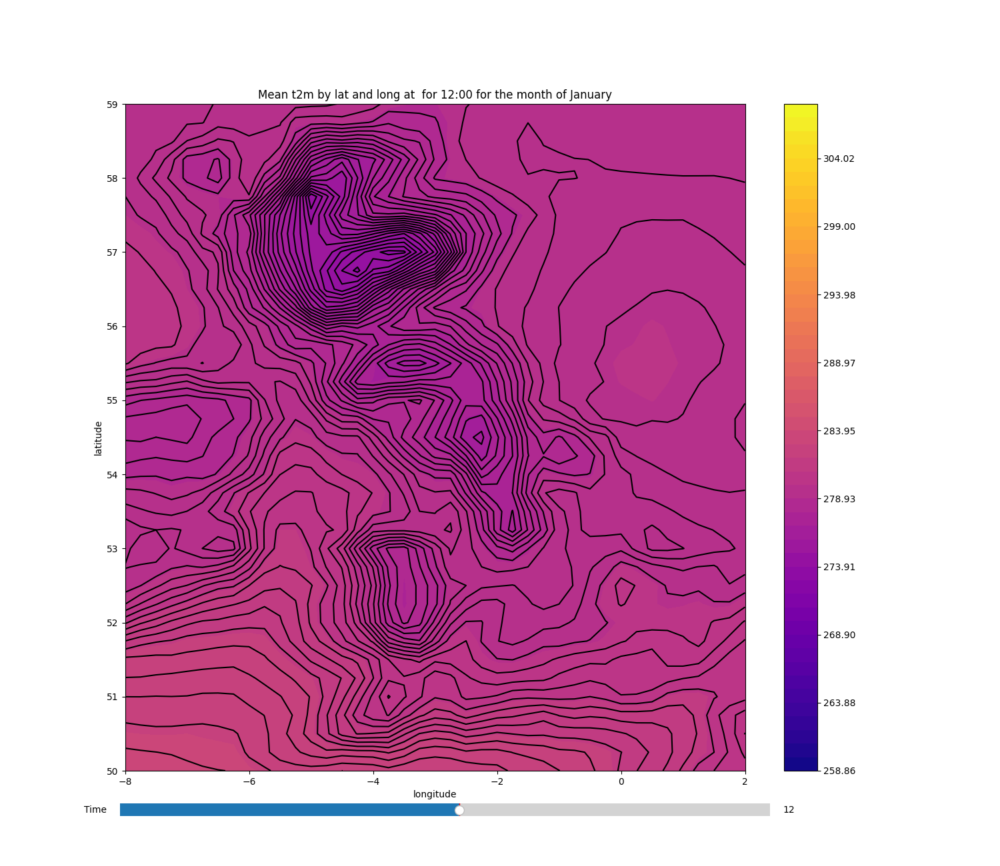

In [54]:
%matplotlib widget
jan_slider = exploration_pipeline(jan_training_1, jan_labels_1, df_train_2_jan, "January", 12, "t2m")

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


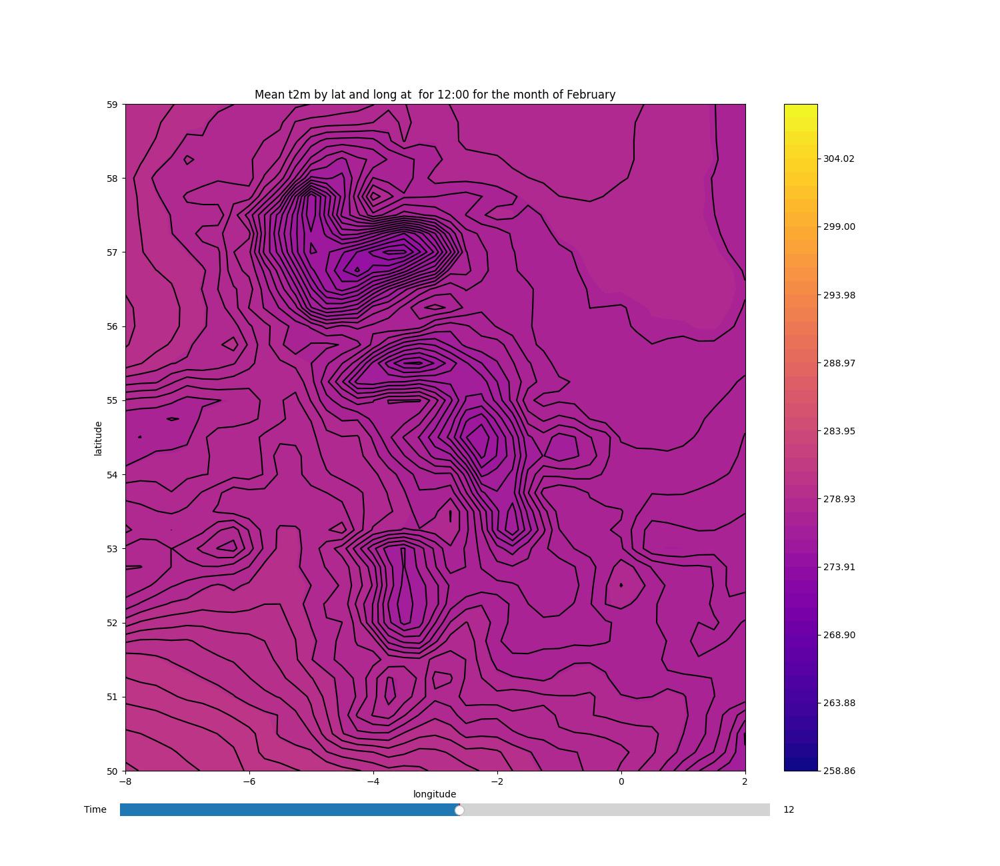

In [55]:
feb_temp_av = exploration_pipeline(feb_training_1, feb_labels_1, df_train_2_feb, "February", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


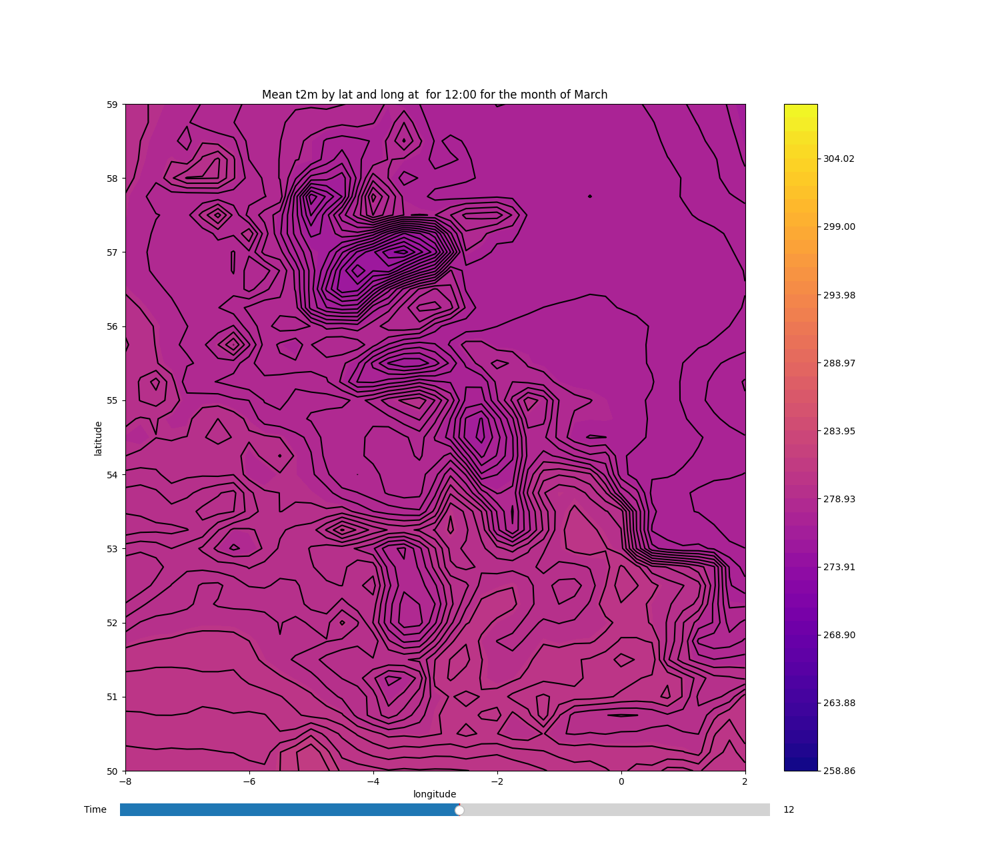

In [56]:
mar_temp_av = exploration_pipeline(mar_training_1, mar_labels_1, df_train_2_mar, "March", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


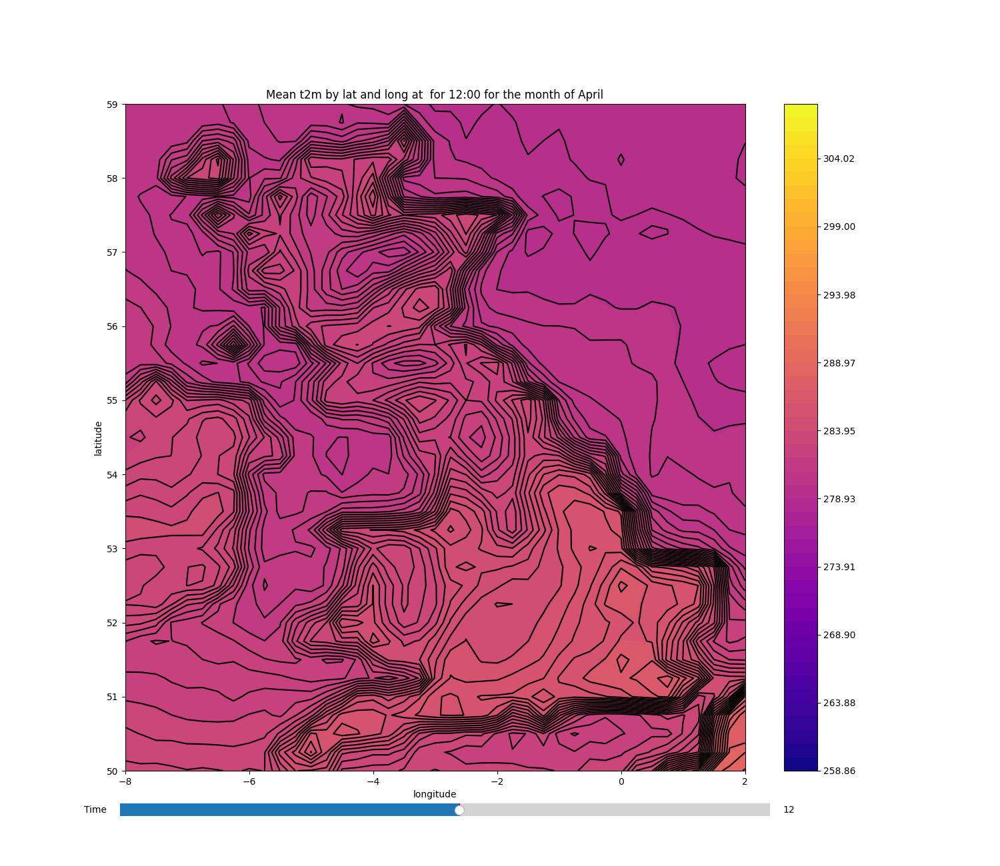

In [57]:
apr_temp_av = exploration_pipeline(apr_training_1, apr_labels_1, df_train_2_apr, "April", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


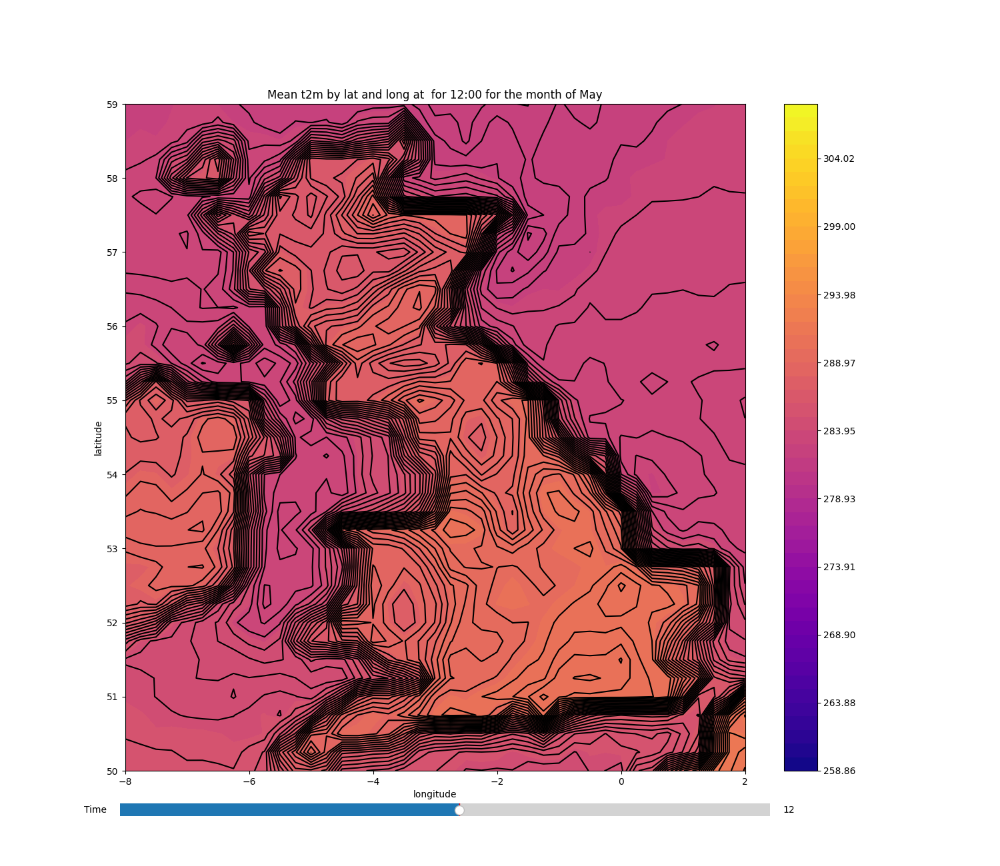

In [58]:
may_temp_av = exploration_pipeline(may_training_1, may_labels_1, df_train_2_may, "May", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


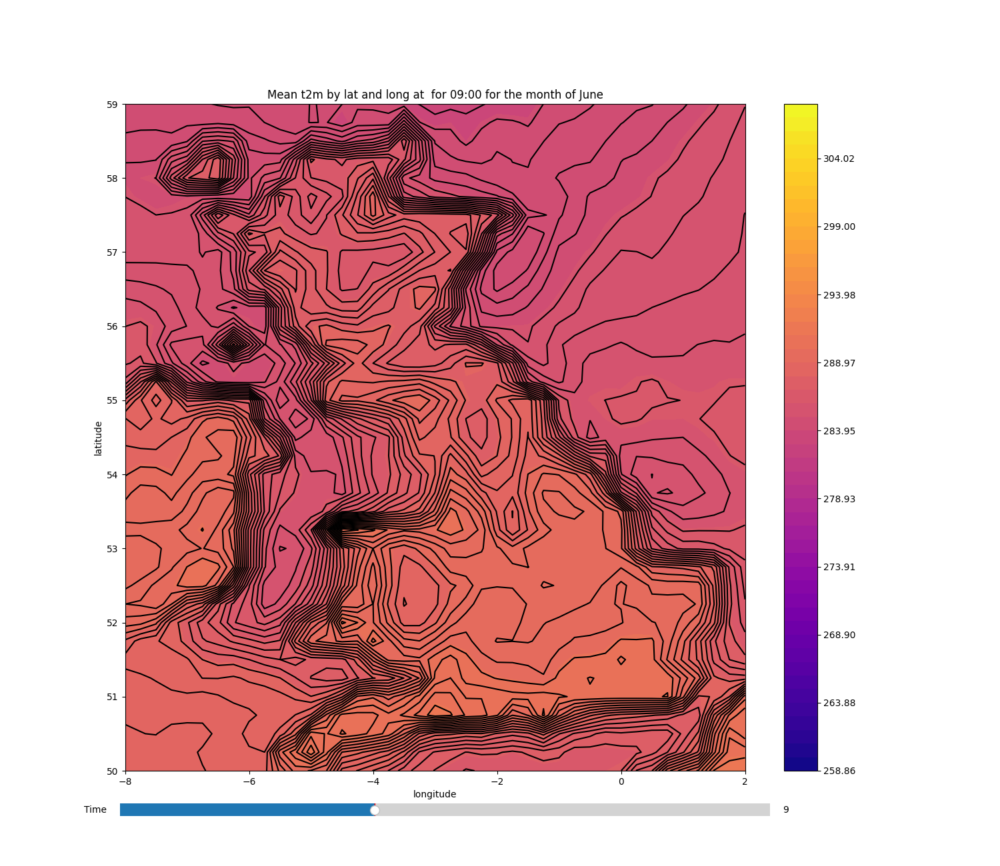

In [59]:
jun_temp_av = exploration_pipeline(jun_training_1, jun_labels_1, df_train_2_jun, "June", 9)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


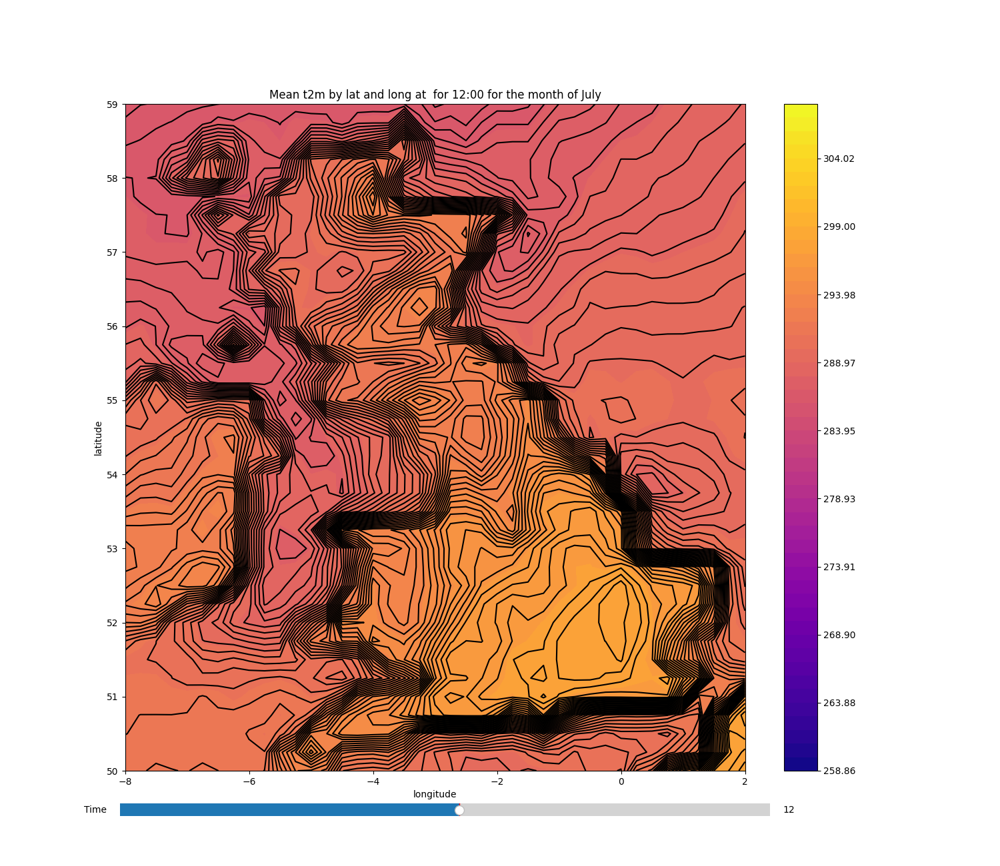

In [60]:
jul_temp_av = exploration_pipeline(jul_training_1, jul_labels_1, df_train_2_jul, "July", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


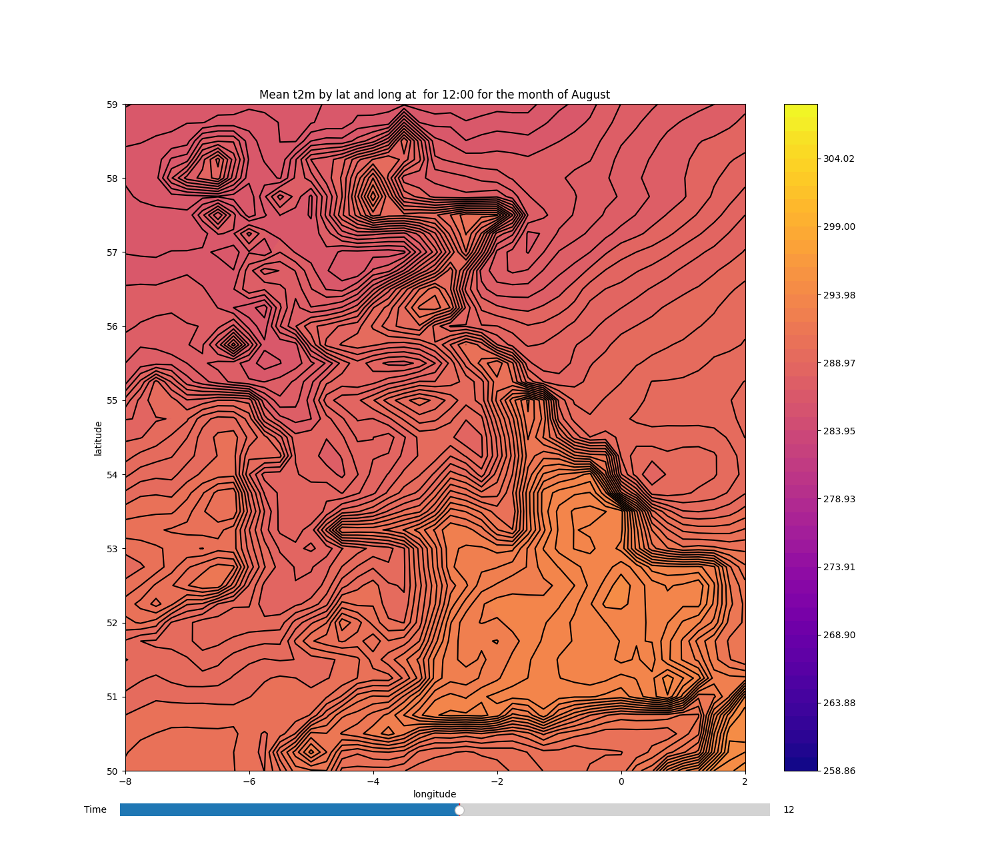

In [61]:
aug_temp_av = exploration_pipeline(aug_training_1, aug_labels_1, df_train_2_aug, "August", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


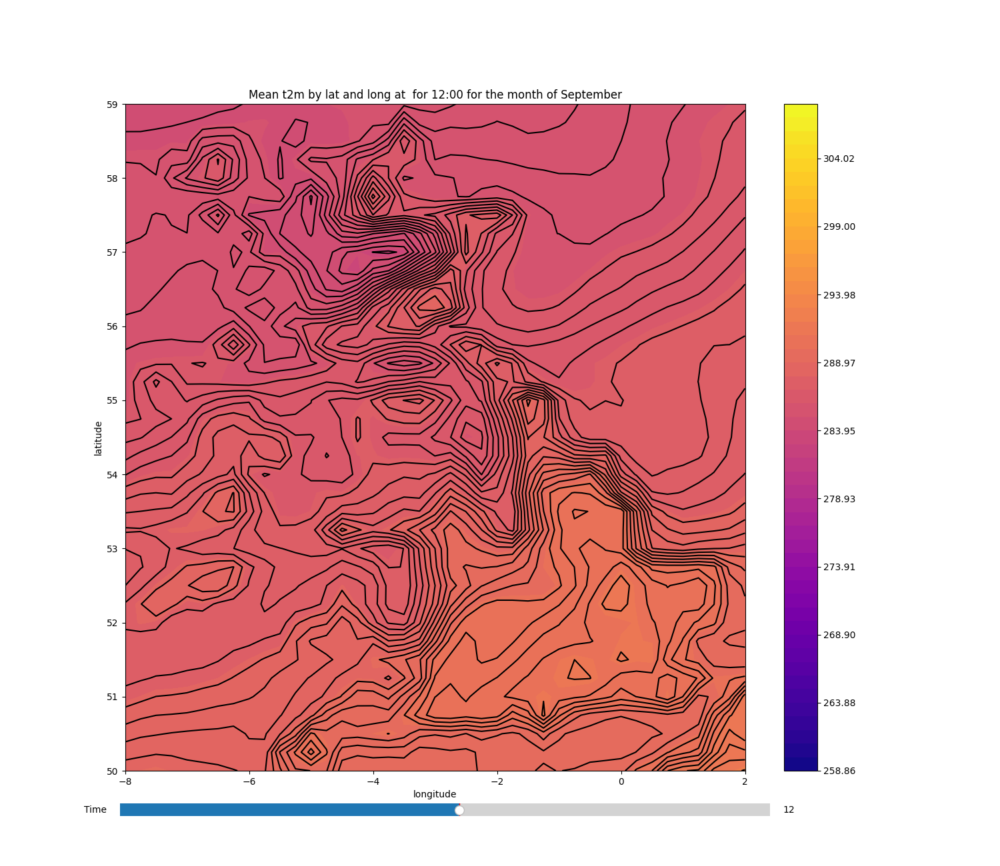

In [62]:
sep_temp_av = exploration_pipeline(sep_training_1, sep_labels_1, df_train_2_sep, "September", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


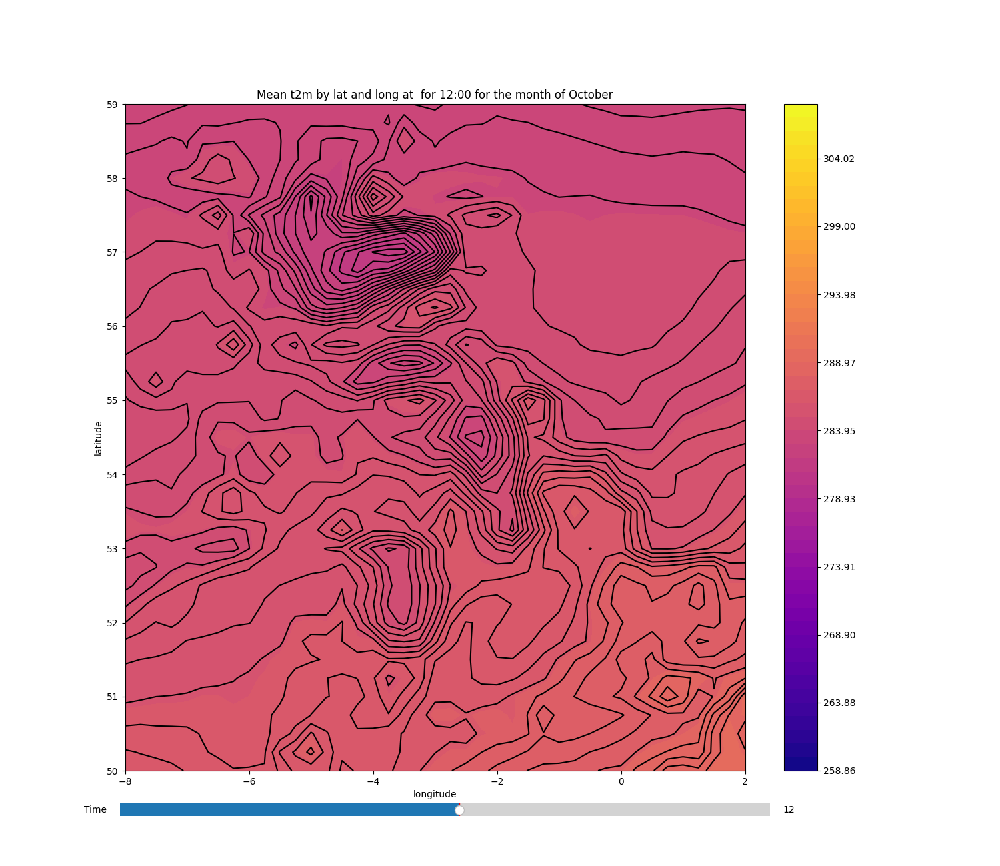

In [63]:
oct_temp_av = exploration_pipeline(oct_training_1, oct_labels_1, df_train_2_oct, "October", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


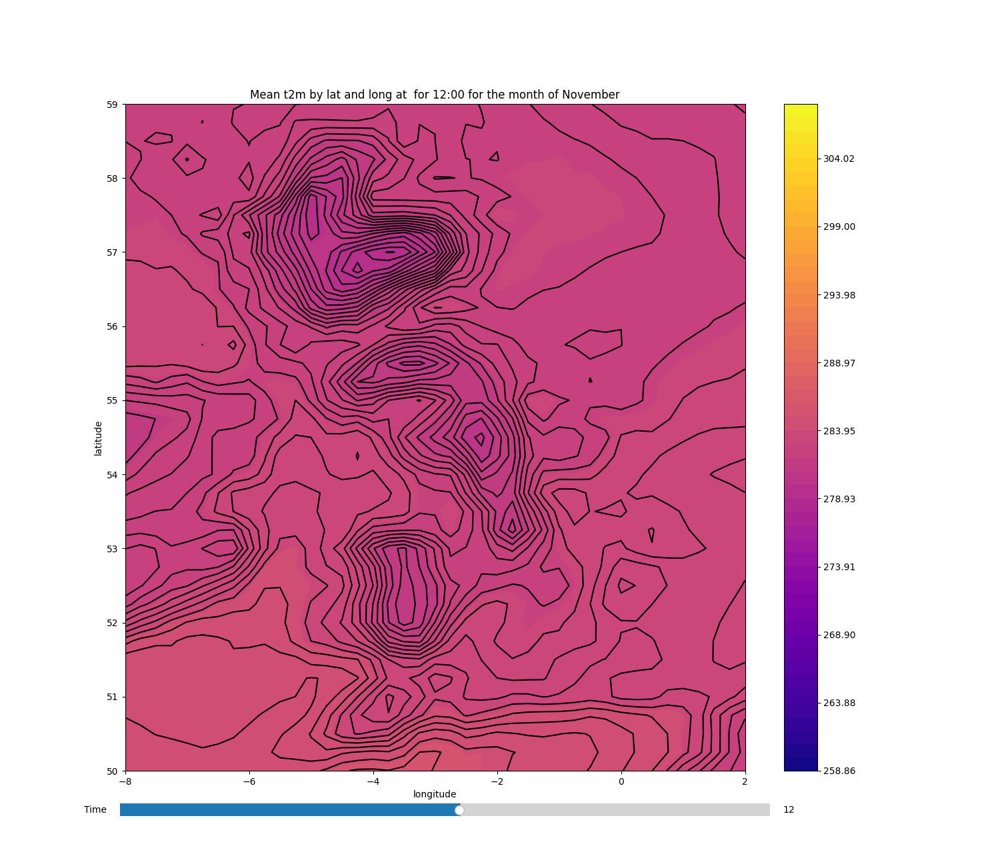

In [64]:
nov_temp_av = exploration_pipeline(nov_training_1, nov_labels_1, df_train_2_nov, "November", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

37


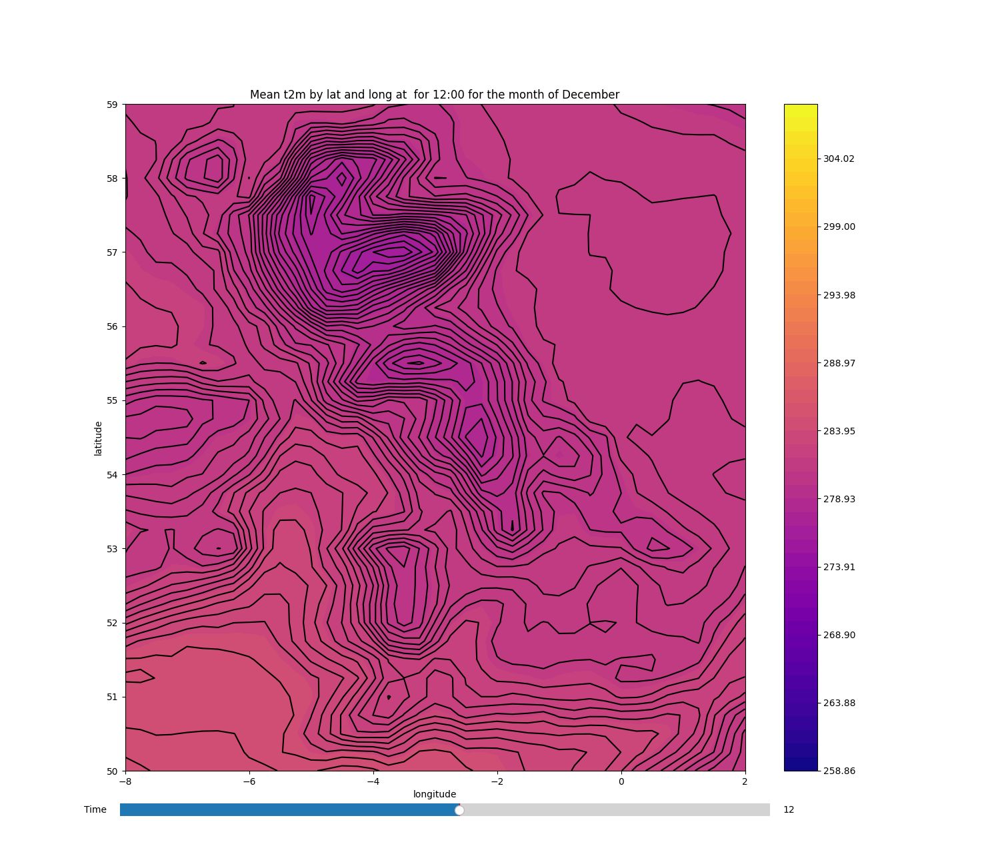

In [65]:
dec_temp_av = exploration_pipeline(dec_training_1, dec_labels_1, df_train_2_dec, "December", 12)

================================================================Divider============================================================================================================
===================================================================================================================================================================================

In [45]:
test_date = datetime.strptime("10:00:00", "%H:%M:%S")
type(test_date.hour)

int

In [46]:
display(df_train_2_jan)
df_train_2_jan["valid_time"] = pd.to_datetime(df_train_2_jan["valid_time"])
print(type(df_train_2_jan["valid_time"]))

df_train_2_jan["hour_value"] = df_train_2_jan["valid_time"].dt.hour
print(type(df_train_2_jan["valid_time"]))

,valid_time,latitude,longitude,tp,u10,v10,sp,u100,v100,tcc,ptype,t2m
0,2018-01-01 00:00:00,59.0,-8.00,3.814697e-06,1.405868,-1.367767,98134.81,1.516388,-1.468002,0.968842,1.0,279.75903
1,2018-01-01 00:00:00,59.0,-7.75,1.668930e-05,2.151962,-1.555267,98086.81,2.239044,-1.634994,0.978790,1.0,279.61255
2,2018-01-01 00:00:00,59.0,-7.50,1.811981e-05,2.691025,-1.585541,98078.81,2.783966,-1.686752,0.975586,1.0,279.71997
3,2018-01-01 00:00:00,59.0,-7.25,1.907349e-05,2.850204,-1.714447,98076.81,2.971466,-1.854721,0.978790,1.0,279.78247
4,2018-01-01 00:00:00,59.0,-7.00,1.525879e-05,3.299423,-1.867767,98084.81,3.455841,-2.001205,0.968842,1.0,279.86646
...,...,...,...,...,...,...,...,...,...,...,...,...
1128643,2018-01-31 23:00:00,50.0,1.00,4.768372e-06,7.161301,0.797836,99820.19,10.050354,0.887756,0.670960,0.0,278.78906
1128644,2018-01-31 23:00:00,50.0,1.25,1.335144e-05,6.527512,0.927719,99650.19,9.523010,1.016663,0.629944,0.0,278.44140
1128645,2018-01-31 23:00:00,50.0,1.50,0.000000e+00,4.782394,1.147446,99414.19,8.528870,1.254944,0.706085,1.0,277.50390
1128646,2018-01-31 23:00:00,50.0,1.75,0.000000e+00,4.490402,1.128891,99345.19,8.212463,1.243225,0.702026,1.0,277.17188


<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>


In [47]:
print(np.zeros([4,2]))

[[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]


Using matplotlib backend: module://ipympl.backend_nbagg


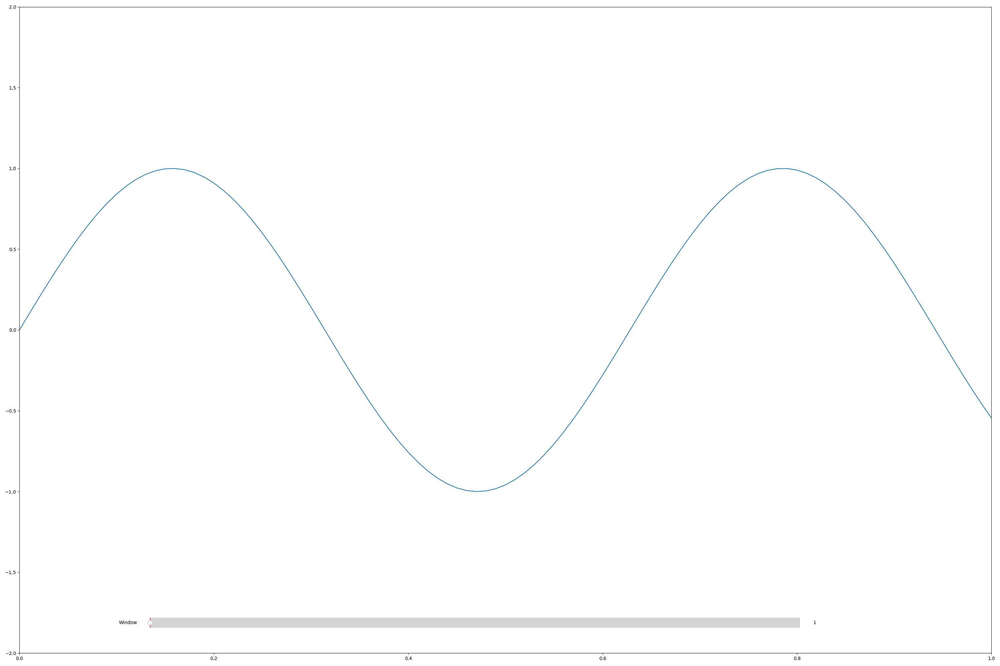

In [48]:
%matplotlib 

from matplotlib.widgets import Slider
import matplotlib.pyplot as plt
from numpy import arange, sin

def myplot():
    t = arange(0.0, 10.0, 0.01)

    fig =plt.figure(figsize = [30,20])
    ax = plt.subplot(111)
    plt.plot(t, sin(t*10))
    plt.ylim((-2,2))
    plt.xlim((0,1))
    plt.tight_layout()

    axzoom= plt.axes([0.15, 0.05, 0.65, 0.03])
    szoom = Slider(axzoom, 'Window', 1, 2)

    def update(val):
        ax.set_xlim([val,val+1])
        fig.canvas.draw_idle()
    szoom.on_changed(update)
    plt.show()
    return szoom

keep_sliders = myplot()